In [1]:
# Convert sound of bird to spectrogram
from fastai.vision.all import Path, get_files
import soundfile as sf
import librosa as lb
import librosa.display as lbd
from IPython.display import Audio
from soundfile import SoundFile
import numpy as np
import matplotlib.pyplot as plt
import random
import os
import pandas as pd 
from fastbook import *
from IPython.display import Image, display, Audio, Markdown
import plotly.express as px

In [2]:
class Config:
    sampling_rate = 32000
    duration = 5
    fmin = 0
    fmax = None
    audios_path = Path("../data/train_audio")
    out_dir_train = Path("specs/train")
    out_dir_valid = Path("specs/valid")

In [3]:
def get_audio_info(filepath):
    """Get some properties from  an audio file"""
    with SoundFile(filepath) as f:
        sr = f.samplerate
        frames = f.frames
        duration = float(frames)/sr
    return {"frames": frames, "sr": sr, "duration": duration}

In [4]:
def compute_melspec(y, sr, n_mels, fmin, fmax):
    """
    Computes a mel-spectrogram and puts it at decibel scale
    Arguments:
        y {np array} -- signal
        params {AudioParams} -- Parameters to use for the spectrogram. Expected to have the attributes sr, n_mels, f_min, f_max
    Returns:
        np array -- Mel-spectrogram
    """
    melspec = lb.feature.melspectrogram(
        y=y, sr=sr, n_mels=n_mels, fmin=fmin, fmax=fmax,
    )

    melspec = lb.power_to_db(melspec).astype(np.float32)
    return melspec

In [5]:
def mono_to_color(X, eps=1e-6, mean=None, std=None):
    mean = mean or X.mean()
    std = std or X.std()
    X = (X - mean) / (std + eps)

    _min, _max = X.min(), X.max()

    if (_max - _min) > eps:
        V = np.clip(X, _min, _max)
        V = 255 * (V - _min) / (_max - _min)
        V = V.astype(np.uint8)
    else:
        V = np.zeros_like(X, dtype=np.uint8)

    return V

In [6]:
sr, n_mels, fmin, fmax  = Config.sampling_rate, 128, Config.fmin, Config.fmax
def audio_to_image(audio):
    melspec = compute_melspec(audio, sr=sr, n_mels = n_mels, fmin=fmin, fmax=fmax)
    image = mono_to_color(melspec)
    return image

In [7]:
path = Path("../data/")
audio_files = get_files(path / "train_audio", extensions=".ogg")
print(f"Found {len(audio_files)} audio files")

Found 24459 audio files


# Initial Goal is to listen so some audio and their spectrogram to get some glimpse

{'frames': 123716, 'sr': 32000, 'duration': 3.866125}


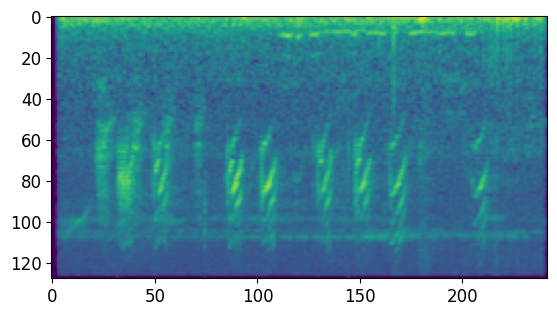

In [8]:
# take a random sample
audio_path = random.choice(audio_files)
info = get_audio_info(audio_path)
print(info)

# Convert to spectrogram
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)

# show spectrogra
plt.imshow(img)
plt.show()

# play audio
y, sr = lb.load(audio_path)
Audio(y, rate=sr)

{'frames': 3868608, 'sr': 32000, 'duration': 120.894}


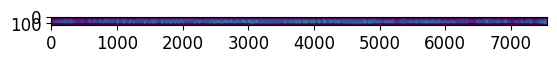

In [9]:
# take a random sample
audio_path = random.choice(audio_files)
info = get_audio_info(audio_path)
print(info)

# Convert to spectrogram
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)

# show spectrogra
plt.imshow(img)
plt.show()

# play audio
y, sr = lb.load(audio_path)
Audio(y, rate=sr)

{'frames': 1243011, 'sr': 32000, 'duration': 38.84409375}


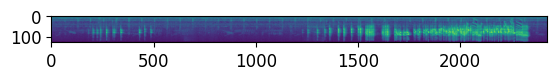

In [10]:
# take a random sample
audio_path = random.choice(audio_files)
info = get_audio_info(audio_path)
print(info)

# Convert to spectrogram
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)

# show spectrogra
plt.imshow(img)
plt.show()

# play audio
y, sr = lb.load(audio_path)
Audio(y, rate=sr)

{'frames': 678912, 'sr': 32000, 'duration': 21.216}


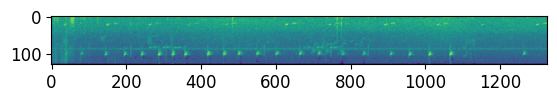

In [11]:
# take a random sample
audio_path = random.choice(audio_files)
info = get_audio_info(audio_path)
print(info)

# Convert to spectrogram
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)

# show spectrogra
plt.imshow(img)
plt.show()

# play audio
y, sr = lb.load(audio_path)
Audio(y, rate=sr)

{'frames': 1741218, 'sr': 32000, 'duration': 54.4130625}


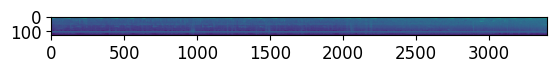

In [12]:
# take a random sample
audio_path = random.choice(audio_files)
info = get_audio_info(audio_path)
print(info)

# Convert to spectrogram
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)

# show spectrogra
plt.imshow(img)
plt.show()

# play audio
y, sr = lb.load(audio_path)
Audio(y, rate=sr)

In [13]:
df = pd.read_csv('../data/train_metadata.csv')
df.shape

(24459, 12)

In [14]:
df.head()

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,url,filename
0,asbfly,[],['call'],39.2297,118.1987,Muscicapa dauurica,Asian Brown Flycatcher,Matt Slaymaker,Creative Commons Attribution-NonCommercial-ShareAlike 3.0,5.0,https://www.xeno-canto.org/134896,asbfly/XC134896.ogg
1,asbfly,[],['song'],51.4030,104.6401,Muscicapa dauurica,Asian Brown Flycatcher,Magnus Hellström,Creative Commons Attribution-NonCommercial-ShareAlike 3.0,2.5,https://www.xeno-canto.org/164848,asbfly/XC164848.ogg
2,asbfly,[],['song'],36.3319,127.3555,Muscicapa dauurica,Asian Brown Flycatcher,Stuart Fisher,Creative Commons Attribution-NonCommercial-ShareAlike 4.0,2.5,https://www.xeno-canto.org/175797,asbfly/XC175797.ogg
3,asbfly,[],['call'],21.1697,70.6005,Muscicapa dauurica,Asian Brown Flycatcher,vir joshi,Creative Commons Attribution-NonCommercial-ShareAlike 4.0,4.0,https://www.xeno-canto.org/207738,asbfly/XC207738.ogg
4,asbfly,[],['call'],15.5442,73.7733,Muscicapa dauurica,Asian Brown Flycatcher,Albert Lastukhin & Sergei Karpeev,Creative Commons Attribution-NonCommercial-ShareAlike 4.0,4.0,https://www.xeno-canto.org/209218,asbfly/XC209218.ogg


In [15]:
df.primary_label.nunique()

182

In [16]:
value_counts = df['primary_label'].value_counts()

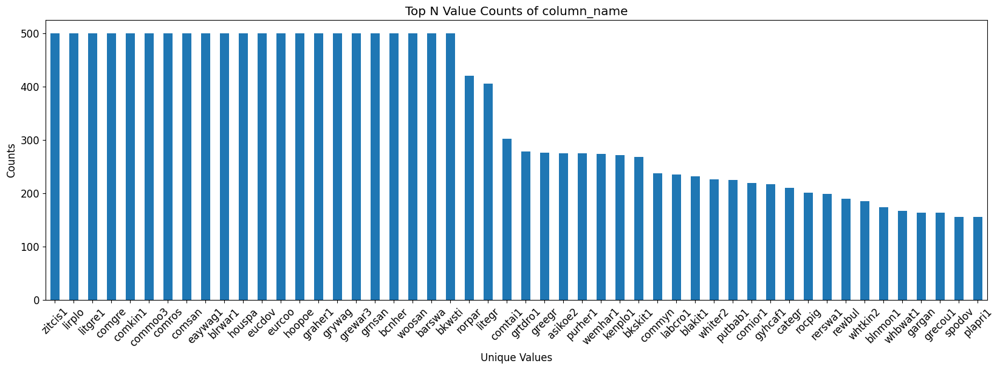

In [17]:
# Plotting only the top N values
top_n = value_counts.head(50) # Adjust N as needed
top_n.plot(kind='bar', figsize=(20, 6))

plt.title('Top N Value Counts of column_name')
plt.xlabel('Unique Values')
plt.ylabel('Counts')
plt.xticks(rotation=45)
plt.show()

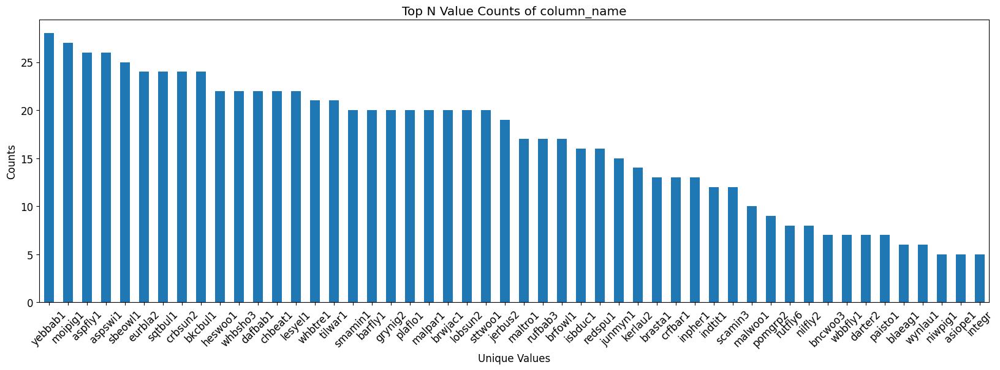

In [18]:
# Plotting only the top N values
top_n = value_counts.tail(50) # Adjust N as needed
top_n.plot(kind='bar', figsize=(20, 6))

plt.title('Top N Value Counts of column_name')
plt.xlabel('Unique Values')
plt.ylabel('Counts')
plt.xticks(rotation=45)
plt.show()

``For few birds 500 samples are present while for some there are only 5``

# Destribution of bird on the global map

In [19]:
fig = px.scatter_mapbox(df, lat='latitude', lon='longitude', color='primary_label', 
                        hover_name='primary_label', hover_data=['latitude', 'longitude'], 
                        title='Geographical Distribution of Bird Species',
                        zoom=1, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

# Lets study information about few birds

total number of bird in the dataset: 28


### Bird Information

**Scientific Name:** Argya affinis

**Common Name:** Yellow-billed Babbler

### Audio Information

Audio Info: {'frames': 354048, 'sr': 32000, 'duration': 11.064} 



### Audio Spectrogram

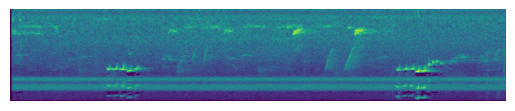

In [20]:
name = "yebbab1"
temp = df.loc[df['primary_label'] == name]
print(f"total number of bird in the dataset: {len(temp)}")
# Download some images of the bird

fig = px.scatter_mapbox(temp, lat='latitude', lon='longitude', color='primary_label', 
                        hover_name='primary_label', hover_data=['latitude', 'longitude'], 
                        title='Geographical Distribution of Bird Species',
                        zoom=1, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

# Assuming 'temp' is a DataFrame with bird data
idx = random.randint(0, len(temp)-1)
entry = temp.iloc[idx]

filename = entry['filename']
scientific_name = entry['scientific_name']
common_name = entry['common_name']
urls = search_images_ddg(common_name, max_images=1)

# Display bird information
display(Markdown(f"### Bird Information"))
display(Markdown(f"**Scientific Name:** {scientific_name}"))
display(Markdown(f"**Common Name:** {common_name}"))
display(Image(url=urls[0], width=300, height=300))

# Audio information
audio_path = os.path.join(Config.audios_path, filename)
info = get_audio_info(audio_path)
display(Markdown(f"### Audio Information"))
print(f"Audio Info: {info} \n")

# Audio Spectrogram
display(Markdown(f"### Audio Spectrogram"))
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)
plt.imshow(img)
plt.axis('off')  # Optional: Hide axis
plt.show()

# Play audio
y, sr = lb.load(audio_path)
display(Audio(y, rate=sr))

**Moipig1**

total number of bird in the dataset: 27


### Bird Information

**Scientific Name:** Ducula badia

**Common Name:** Mountain Imperial-Pigeon

### Audio Information

Audio Info: {'frames': 589322, 'sr': 32000, 'duration': 18.4163125} 



### Audio Spectrogram

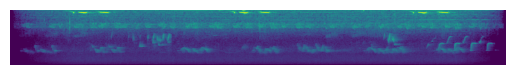

In [21]:
name = "moipig1"
temp = df.loc[df['primary_label'] == name]
print(f"total number of bird in the dataset: {len(temp)}")
# Download some images of the bird

fig = px.scatter_mapbox(temp, lat='latitude', lon='longitude', color='primary_label', 
                        hover_name='primary_label', hover_data=['latitude', 'longitude'], 
                        title='Geographical Distribution of Bird Species',
                        zoom=1, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

# Assuming 'temp' is a DataFrame with bird data
idx = random.randint(0, len(temp)-1)
entry = temp.iloc[idx]

filename = entry['filename']
scientific_name = entry['scientific_name']
common_name = entry['common_name']
urls = search_images_ddg(common_name, max_images=1)

# Display bird information
display(Markdown(f"### Bird Information"))
display(Markdown(f"**Scientific Name:** {scientific_name}"))
display(Markdown(f"**Common Name:** {common_name}"))
display(Image(url=urls[0], width=300, height=300))

# Audio information
audio_path = os.path.join(Config.audios_path, filename)
info = get_audio_info(audio_path)
display(Markdown(f"### Audio Information"))
print(f"Audio Info: {info} \n")

# Audio Spectrogram
display(Markdown(f"### Audio Spectrogram"))
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)
plt.imshow(img)
plt.axis('off')  # Optional: Hide axis
plt.show()

# Play audio
y, sr = lb.load(audio_path)
display(Audio(y, rate=sr))

total number of bird in the dataset: 5


### Bird Information

**Scientific Name:** Ardea intermedia

**Common Name:** Intermediate Egret

### Audio Information

Audio Info: {'frames': 150465, 'sr': 32000, 'duration': 4.70203125} 



### Audio Spectrogram

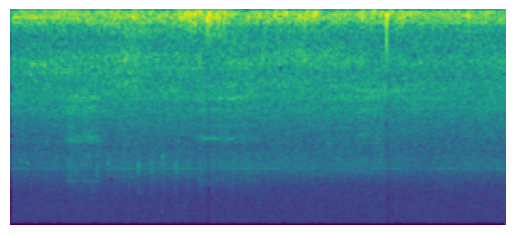

In [22]:
name = "integr"
temp = df.loc[df['primary_label'] == name]
print(f"total number of bird in the dataset: {len(temp)}")
# Download some images of the bird

fig = px.scatter_mapbox(temp, lat='latitude', lon='longitude', color='primary_label', 
                        hover_name='primary_label', hover_data=['latitude', 'longitude'], 
                        title='Geographical Distribution of Bird Species',
                        zoom=1, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

# Assuming 'temp' is a DataFrame with bird data
idx = random.randint(0, len(temp)-1)
entry = temp.iloc[idx]

filename = entry['filename']
scientific_name = entry['scientific_name']
common_name = entry['common_name']
urls = search_images_ddg(common_name, max_images=1)

# Display bird information
display(Markdown(f"### Bird Information"))
display(Markdown(f"**Scientific Name:** {scientific_name}"))
display(Markdown(f"**Common Name:** {common_name}"))
display(Image(url=urls[0], width=300, height=300))

# Audio information
audio_path = os.path.join(Config.audios_path, filename)
info = get_audio_info(audio_path)
display(Markdown(f"### Audio Information"))
print(f"Audio Info: {info} \n")

# Audio Spectrogram
display(Markdown(f"### Audio Spectrogram"))
audio, sr = sf.read(audio_path)
img = audio_to_image(audio)
plt.imshow(img)
plt.axis('off')  # Optional: Hide axis
plt.show()

# Play audio
y, sr = lb.load(audio_path)
display(Audio(y, rate=sr))